## Capstone project Roadmap:Employee Churn Model with Strategic Retention Plan 

<ol>
<li> <b> Problem Overview </b> </li>
</ol>


<ol start="2">
<li> <b> Problem Statement </b> </li>
</ol>


<ol   start="3">
<li> <b> Sourcing and loading </b> </li>
</ol>


<ul>
<li>Import packages</li>
<li>Load data</li>
<li>Explore the data</li>
</ul>

<ol start="4">
  <li>  <b> Summary Statistic </b> </li>
</ol>

<ul>
<li> Numerical variables</li>
<li> Categorical variables</li>
</ul>



<ol start="5">
 <li><b> Cleaning, transforming and visualizing</b> </li>
 </ol>
 
 <ul>
<li>Check missing values</li>
<li> Pandas ProfileReport </li>
<li> Range of values </li>
<li> Features engineering </li>
<li> Check outliers </li>
</ul>

<ol start="6">
 <li><b> Features Selection </b> </li>
 </ol>
 <ul>
<li>Dummies variables </li>
<li> Constant features </li>
<li> Correlated features </li>
<li> Train/test split </li>
</ul>

<ol start="7">
 <li><b> Modeling </b> </li>
 </ol>

<ol start="8">
 <li><b> Documentation </b> </li>
 </ol>

### 1.Project Overview 

<p> Many organizations have found that turnover is a very costly problem. Turnover is a process in which employees leave an organization. Employees leave the company voluntarily or involuntarily. In either way, companies have to replace them. The extent to which employers face turnover rates and the cost often varies by organizations and industries. Depending on the organization or industries, management has to pay particular attention to the turnover rate since it can reduce the productivity and loss of clients that affect the company's long-run bottom line. In this project, we will try to uncover the key variables that contribute to employees' turnover.</p>

### 2. Problem Statement 

 As we stated in the problem overview, employee turnover is costly for a company in the sense that it could affect the bottom line of the organization in the long run. Understanding the drivers of the phenomenon could help managers be proactive, keep their high performer employees, and maintain the company's sustainable development. In this HR predictive analysis, we will use a machine learning model to uncover the key indicators that lead an employee to leave the company. knowing in advance those indicators help management to implement a comprehensive employee engagement and inclusion program</p><br>
<strong>In this study, we will attempt to solve the following problem statement is:</strong><br>
<strong>What is the propensity of an active employee leaving the company?</strong><br>
<strong>What are the causes of an employee leaving the company?</strong><br>
<strong>What strategic plan can be adopted based on the results to improve employee retention ?</strong>

### 3. Sourcing and Loading 

#### 3.1 Import packages

In [1]:
import pandas as pd
from IPython.display import Markdown, display
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns 
import numpy as np
from sklearn import metrics
 
def printmd(string):
    display(Markdown(string))     
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC 
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score, f1_score 
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')

#### 3.2  Load the data set  

In [2]:
# load the dataframe   
df = pd.read_csv('/Users/kouamengoran/desktop/WA_Fn-UseC_-HR-Employee-Attrition.csv')

#### 3.3 Explore the data set 

In [3]:
# The shape of the dataset 
df.shape

(1470, 35)

<p> The dataset has  1479  rows and 35 columns </p>

In [4]:
# check the five first rows of the dataset 
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [5]:
# Display the columns of the dataset 
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

####  Description of  Columns
1. Age (numeric)
2. Attrition ( target variable "yes' for leaving and 'no' for not leaving )
3. BusinessTravel 
4. DailyRate 
5. Department
6. DistanceFromHome
7. Education
8. EducationField
9. EmployeeCount
10. EmployeeNumber
11. EnvironmentSatisfaction
12. Gender
13. HourlyRate'
14. JobInvolvement
15. JobLevel
16. JobRole
17. JobSatisfaction
18. MaritalStatus
19. MonthlyIncome
20. MonthlyRate
21. NumCompaniesWorked
22. Over18
23. OverTime
24. PercentSalaryHike
25. PerformanceRating
26. RelationshipSatisfaction: Relationship Satisfaction is captured as: 1 'Low', 2 'Medium', 3 'High', 4 'Very High'.
27. StandardHours
28. StockOptionLevel
29. TotalWorkingYears
30. TrainingTimesLastYear
31. WorkLifeBalance
32. YearsAtCompany
33. YearsInCurrentRole
34. YearsSinceLastPromotion
35. YearsWithCurrManager

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [7]:
df.select_dtypes(include=["object"])

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
0,Yes,Travel_Rarely,Sales,Life Sciences,Female,Sales Executive,Single,Y,Yes
1,No,Travel_Frequently,Research & Development,Life Sciences,Male,Research Scientist,Married,Y,No
2,Yes,Travel_Rarely,Research & Development,Other,Male,Laboratory Technician,Single,Y,Yes
3,No,Travel_Frequently,Research & Development,Life Sciences,Female,Research Scientist,Married,Y,Yes
4,No,Travel_Rarely,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No
...,...,...,...,...,...,...,...,...,...
1465,No,Travel_Frequently,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No
1466,No,Travel_Rarely,Research & Development,Medical,Male,Healthcare Representative,Married,Y,No
1467,No,Travel_Rarely,Research & Development,Life Sciences,Male,Manufacturing Director,Married,Y,Yes
1468,No,Travel_Frequently,Sales,Medical,Male,Sales Executive,Married,Y,No


In [8]:
# check the different labels of the business travel variable
df.BusinessTravel.unique()

array(['Travel_Rarely', 'Travel_Frequently', 'Non-Travel'], dtype=object)

In [9]:
# The distribution of the labels 
df.BusinessTravel.value_counts()

Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: BusinessTravel, dtype: int64

In [10]:
#check the different labels of the department variable
df.Department.unique()

array(['Sales', 'Research & Development', 'Human Resources'], dtype=object)

In [11]:
#The distribution of the labels 
df.Department.value_counts()

Research & Development    961
Sales                     446
Human Resources            63
Name: Department, dtype: int64

In [12]:
# distribution of the labels of  EductionField variables 
df.EducationField.value_counts()

Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: EducationField, dtype: int64

In [13]:
#distribution of the labels of  Gender variables 
df.Gender.value_counts()

Male      882
Female    588
Name: Gender, dtype: int64

In [14]:
df.JobRole.value_counts()

Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representative          83
Research Director             80
Human Resources               52
Name: JobRole, dtype: int64

In [15]:
#distribution of the labels of MaritalStatus variables 
df.MaritalStatus.value_counts()

Married     673
Single      470
Divorced    327
Name: MaritalStatus, dtype: int64

In [16]:
#  distribution of Over18 variable 
df.Over18.value_counts()

Y    1470
Name: Over18, dtype: int64

In [17]:
# distribution of the labels of OverTime Variable
df.OverTime.value_counts()

No     1054
Yes     416
Name: OverTime, dtype: int64

In [18]:
#  distribution of performance rating variable 
df.PerformanceRating.value_counts()

3    1244
4     226
Name: PerformanceRating, dtype: int64

In [19]:
df.PerformanceRating

0       3
1       4
2       3
3       3
4       3
       ..
1465    3
1466    3
1467    4
1468    3
1469    3
Name: PerformanceRating, Length: 1470, dtype: int64

#### 4. Summary Statistic 

#### 4.1 Numerical  variables 

In [20]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


#### 4.2 Categorical variables

In [21]:
df.describe(include=['object'])

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,1,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1233,1043,961,606,882,326,673,1470,1054


In [22]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


**<font color='teal'> We do not have high cardinality variables. Only the variable  `JobRole` has 9 labels.</font>**

In [23]:
#The recap of the info information  
dtype_df = df.dtypes.reset_index()
dtype_df.columns = ["Count", "Column Type"]
dtype_df.groupby("Column Type").aggregate('count').reset_index()

,Column Type,Count
0,int64,26
1,object,9


In [24]:
# distribution of JobRole Variable 
df.JobRole.value_counts(normalize=True)

Sales Executive              0.221769
Research Scientist           0.198639
Laboratory Technician        0.176190
Manufacturing Director       0.098639
Healthcare Representative    0.089116
Manager                      0.069388
Sales Representative         0.056463
Research Director            0.054422
Human Resources              0.035374
Name: JobRole, dtype: float64

### 5. Data cleaning and  visualization 

<p>This third stage is arguably the most important part of any Data Science project. The first thing to do is take a proper look at the data. Cleaning forms the majority of this stage, and can be done both before or after Transformation.</p>

<p> we have 26  int64 types and 9 object type </p>

In [25]:
# Check of missing values 
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

<p> No missing value in the dataset </p> 

#### 5. 1 Use pandas  ProfileReport 

In [26]:
import  pandas_profiling
from pandas_profiling import ProfileReport 
from pandas_profiling.utils.cache import cache_file

In [27]:
profile = ProfileReport(df , title= " My Capstone  project Number 2 ", html ={ "style": {'full_width': True}})
profile

<p> We note that the varaibes MonthlyIncome and Joblevel are higly correlated. JobRole and Department are also hijghly correlated  </p>

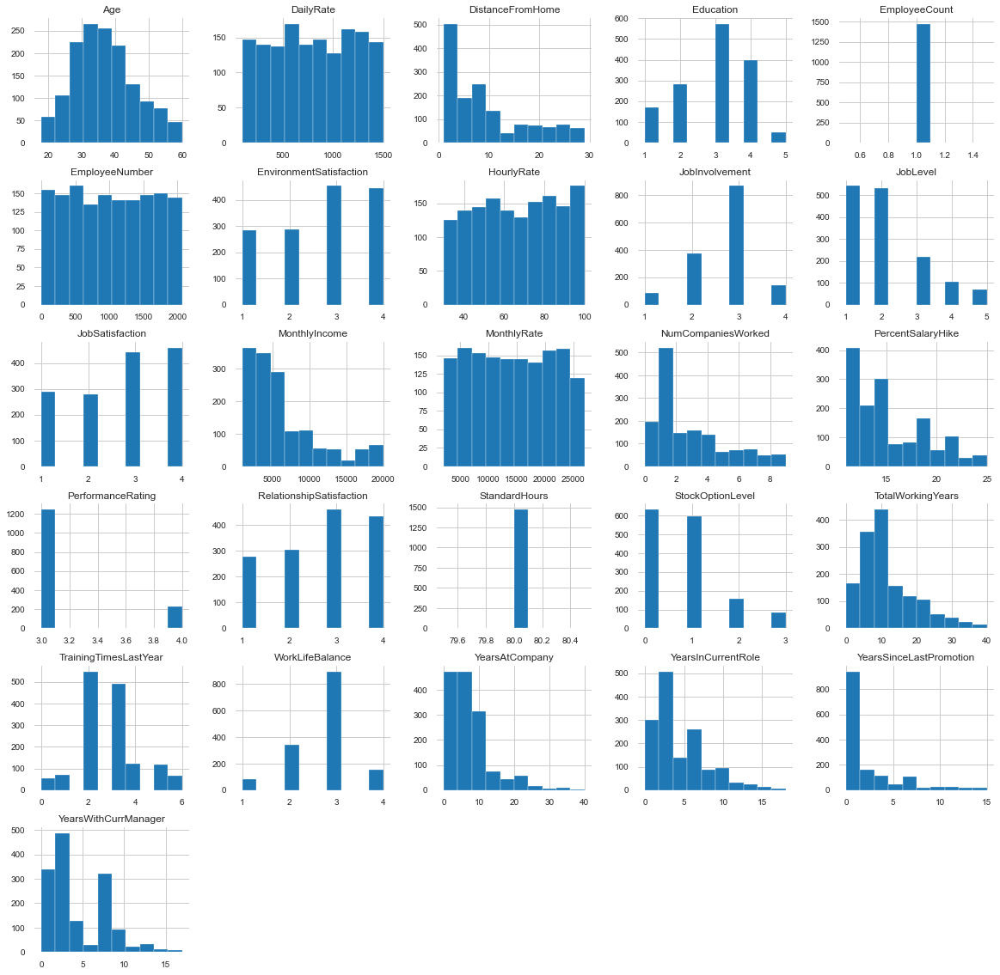

In [28]:
# display the histogram for  numerical variable 
df.hist(figsize=(20,20))
plt.show()


<p> The observation of the histogram shows that, DistanceFromHome, MonthlyIncome,  
NumCompaniesWorked, PercentSalaryHike, TotalWorkingYears ,YearsAtCompany, YearsInCurrentRole, YearsSinceLastPromotion, YearsWithCurrManager are skewed to the right. We notice the presence of outliers. </p>

#### 5.2 Range of values 

In [29]:
df_range = df.select_dtypes(include=['int64'])
rang = df_range.agg(['min', 'max'])
rang= rang.transpose()
print(rang)

                           min    max
Age                         18     60
DailyRate                  102   1499
DistanceFromHome             1     29
Education                    1      5
EmployeeCount                1      1
EmployeeNumber               1   2068
EnvironmentSatisfaction      1      4
HourlyRate                  30    100
JobInvolvement               1      4
JobLevel                     1      5
JobSatisfaction              1      4
MonthlyIncome             1009  19999
MonthlyRate               2094  26999
NumCompaniesWorked           0      9
PercentSalaryHike           11     25
PerformanceRating            3      4
RelationshipSatisfaction     1      4
StandardHours               80     80
StockOptionLevel             0      3
TotalWorkingYears            0     40
TrainingTimesLastYear        0      6
WorkLifeBalance              1      4
YearsAtCompany               0     40
YearsInCurrentRole           0     18
YearsSinceLastPromotion      0     15
YearsWithCur

<p> There are no missing values </p> 

In [30]:
# check  the distribution of the target variable 

In [31]:
df["Attrition"] = [1 if x == "Yes" else 0 for x in df["Attrition"]]

In [32]:
# take a look on the response variable 
df['Attrition'].value_counts()/1470


0    0.838776
1    0.161224
Name: Attrition, dtype: float64

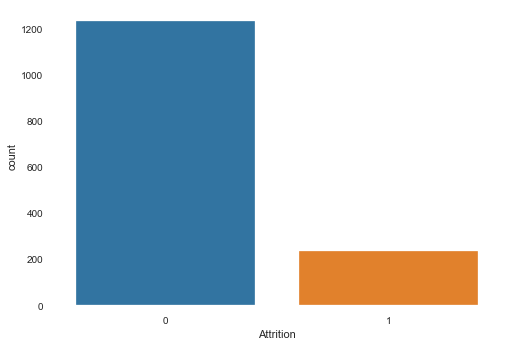

In [33]:
sns.countplot(x='Attrition',data= df)
plt.show()

**We have imballanced data set. we need to  look at close the issiue**

Text(0.5, 1.0, 'Attrition repatition by Gender')

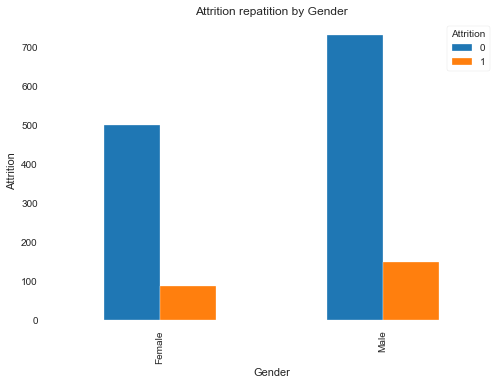

In [34]:
# the repartition of Attrition by gender 
Ct= pd.crosstab(df['Gender'], df['Attrition'])
Ct.plot.bar(stacked=False)
plt.xlabel('Gender')
plt.ylabel('Attrition')
plt.title('Attrition repatition by Gender')

**<font color='teal'> The male's attrition level is greater than women's attrition </font>**

Text(0.5, 1.0, 'Attrition repatition by JobRole')

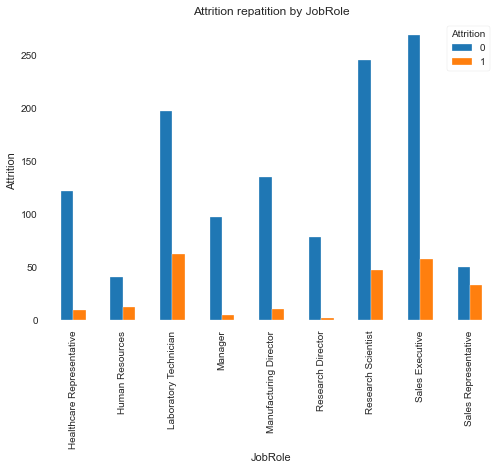

In [35]:
CT= pd.crosstab(df['JobRole'], df['Attrition'])
CT.plot.bar(stacked=False)
plt.xlabel('JobRole')
plt.ylabel('Attrition')
plt.title('Attrition repatition by JobRole')

Text(0.5, 1.0, 'Attrition repatition by JobRole')

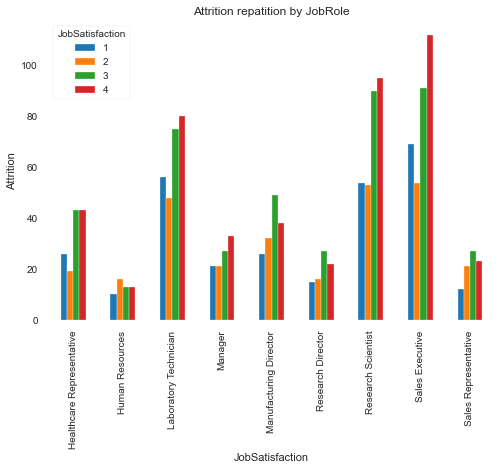

In [36]:
JobS= pd.crosstab(df.JobRole, df.JobSatisfaction)
JobS.plot.bar(stacked=False)
plt.xlabel('JobSatisfaction')
plt.ylabel('Attrition')
plt.title('Attrition repatition by JobRole')

**<font color='teal'> There are more unsatisfied workers among laboratory technician and  sales ecexutive</font>**

Text(0.5, 1.0, 'Attrition repatition by BusinessTravel')

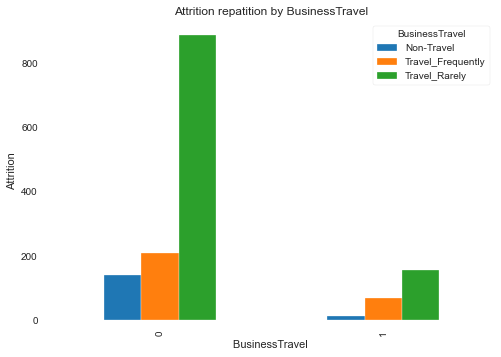

In [37]:
JobTravel= pd.crosstab(df.Attrition, df.BusinessTravel)
JobTravel.plot.bar(stacked=False)
plt.xlabel('BusinessTravel ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by BusinessTravel')

Text(0.5, 1.0, 'Attrition repatition by Department')

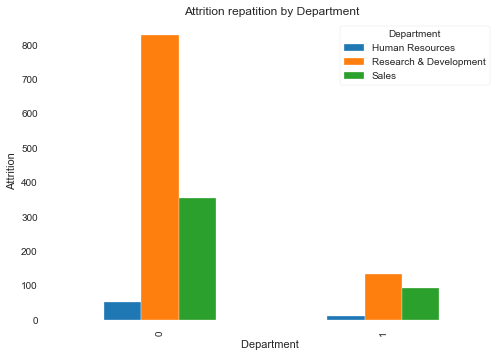

In [38]:
JobTravel= pd.crosstab(df.Attrition, df.Department)
JobTravel.plot.bar(stacked=False)
plt.xlabel('Department ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by Department')

####  5.3  Features Engineering 

<p>In this step, base on the domain knowledge, we will create meaningful features by combining, subtracting, or squaring existing features. That will improve the performance of the algorithms that we will choose to train the model.</p>

**One of the causes of employee attrition is the lack of opportunity for growth and development. We will create a new feature called grothw_advanced and training.**

In [39]:
def growthAdvanced(data) :
    if data['TrainingTimesLastYear'] <= 3 and data['TrainingTimesLastYear'] <= 6:
        return 0
    else:
        return 1
df['growthAdvanced']= df.apply(lambda data:growthAdvanced(data), axis =1)

 **We combine  the variables  EnvironementSatisfaction, JobSatisfactionand RelationshipSatisfaction JobInvolment and workLifeBalance to create TotalSatisfaction_mean  Variable.**

In [40]:
# total Satisfaction  variable 

df['TotalSatisfaction_mean'] = (df['RelationshipSatisfaction']  + 
                                  df['EnvironmentSatisfaction'] + df['JobSatisfaction'] 
                                  + df['JobInvolvement'] + df['WorkLifeBalance'])/5

**We create a variable NotSatisf  for TotalSatisfaction  inferior to 2.35**

In [41]:
# NotSatisfy  vaiable 
def NotSatisf(data) : 
    if  data['TotalSatisfaction_mean'] < 2.35 :
        return 0
    else : 
        return 1
df['NotSatisf'] = df.apply(lambda data: NotSatisf(data) ,axis = 1)

 **We combine StockOptionLevel and  JobSatisfaction  to creat Inclusion Variable. We suppose  an employee is inclused in the company when  he have a stockOption and satisfied** 

In [42]:
df['Inclusion']= (df['JobSatisfaction']+ df['StockOptionLevel'])/2

**The employee is not incluse enough if the inclusion variable is less than 2** 

In [43]:
def NotInclude(data): 
    if  data['Inclusion']< 2 :
        return 0
    else : 
        return 1
df['NotInclude'] = df.apply(lambda data:NotInclude(data),axis = 1)

**Create the variable engage  when the employee over 35 and not single**

In [44]:
def Engaged(data) : 
    if data['Age'] > 35 and data['MaritalStatus'] != 'Single':
        return 1
    else : 
        return 0
df['Engaged'] = df.apply(lambda data:Engaged(data) ,axis = 1)


**Create a variable YoungBadPaid for the Employee between 23 and  35 and montly Income lower than 3500**

In [45]:
def YoungAndBadPaid(data): 
    if data['Age'] < 35 and data['Age'] > 23 and (data['MonthlyIncome'] < 3500):
        return 1
    else : 
        return 0
df['YoungAndBadPaid'] = df.apply(lambda data:YoungAndBadPaid(data) ,axis = 1)

**The stressfulEnv is when the  employee  does overtime, 
travail for business and  not single**  

In [46]:
def StressfulEnV(data): 
    if data['OverTime ']== 'YES' and data['Business travel ']== 'Travel_Frequently'  and data['MaritalStatus'] != 'Single':
        return 1
    else : 
        return 0
df['StressfullEnV'] = df.apply(lambda data:YoungAndBadPaid(data) ,axis = 1)

<p> Create the variable Lack_promotion when  YearIncurentRole is greater than 6 
and  YearSinceLastPromotion  less than 6   </p>

In [47]:
def lack_promotion(data): 
    if data['YearsInCurrentRole'] >= 6 and data['YearsSinceLastPromotion']<=6:
        return 1
    else : 
        return 0
df['lack_promotion'] = df.apply(lambda data:lack_promotion(data) ,axis = 1)

Text(0.5, 1.0, 'Attrition repatition by growthAdvanced')

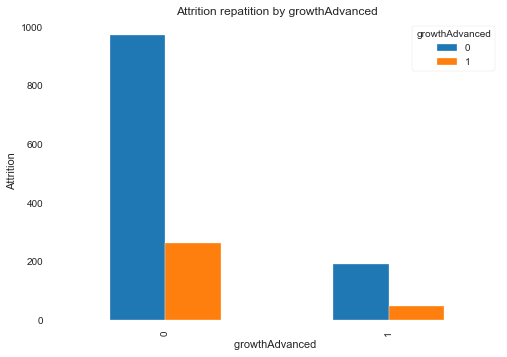

In [48]:
growthAdvanced= pd.crosstab(df.Attrition, df.growthAdvanced)
growthAdvanced.plot.bar(stacked=False)
plt.xlabel('growthAdvanced ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by growthAdvanced')

<p> We observe high attrition of the employee who do not have traning opportunitiny</p>

Text(0.5, 1.0, 'Attrition repatition by TotalSatisfaction')

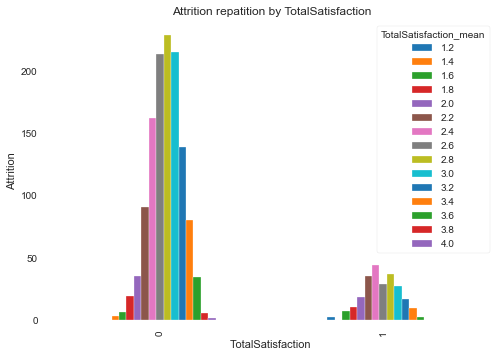

In [49]:
TotalSatisfaction_mean= pd.crosstab(df.Attrition, df.TotalSatisfaction_mean)
TotalSatisfaction_mean.plot.bar(stacked=False)
plt.xlabel('TotalSatisfaction ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by TotalSatisfaction')

In [50]:
df['NotSatisf']

0       0
1       1
2       1
3       1
4       1
       ..
1465    1
1466    0
1467    1
1468    1
1469    1
Name: NotSatisf, Length: 1470, dtype: int64

Text(0.5, 1.0, 'Attrition repatition by NotSatisf')

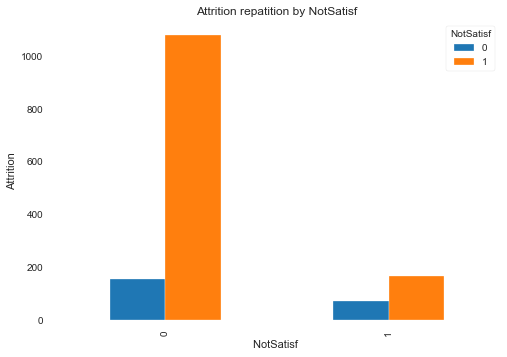

In [51]:
NotSatisf= pd.crosstab(df.Attrition, df.NotSatisf)
NotSatisf.plot.bar(stacked=False)
plt.xlabel('NotSatisf ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by NotSatisf')

Text(0.5, 1.0, 'Attrition repatition by NotInclude')

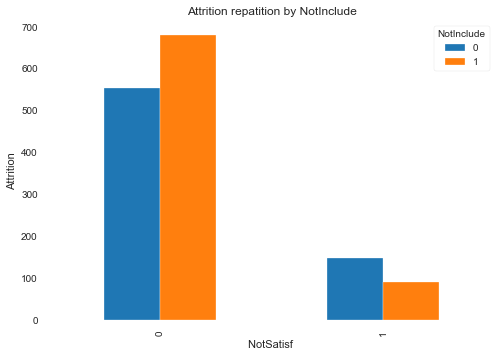

In [52]:
NotInclude= pd.crosstab(df.Attrition, df.NotInclude)
NotInclude.plot.bar(stacked= False)
plt.xlabel('NotSatisf ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by NotInclude')

Text(0.5, 1.0, 'Attrition repatition by lack_promotion')

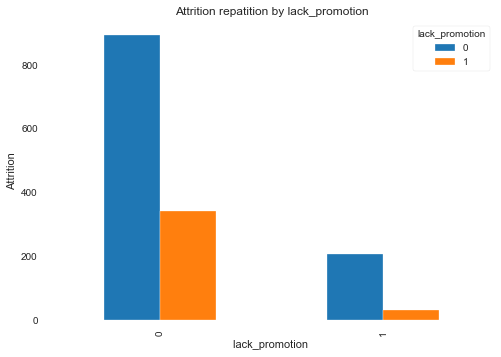

In [53]:
Lack_promotion= pd.crosstab(df.Attrition, df['lack_promotion'])
Lack_promotion.plot.bar(stacked= False)
plt.xlabel('lack_promotion ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by lack_promotion')

In [54]:
df.shape

(1470, 44)

In [55]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,YearsWithCurrManager,growthAdvanced,TotalSatisfaction_mean,NotSatisf,Inclusion,NotInclude,Engaged,YoungAndBadPaid,StressfullEnV,lack_promotion
0,41,1,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,5,0,2.2,0,2.0,1,0,0,0,0
1,49,0,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,7,0,2.8,1,1.5,0,1,0,0,1
2,37,1,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,0,0,2.8,1,1.5,0,0,0,0,0
3,33,0,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,0,0,3.2,1,1.5,0,0,1,1,1
4,27,0,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,2,0,2.6,1,1.5,0,0,1,1,0


####  5.4 Check  the outliers 

In [56]:
def diagnostic_plot(dataset, variable):
    
    plt.figure(figsize=(16,4))
    
    #histogram
    plt.subplot(1,3,1)
    sns.distplot(df[variable], bins=30)
    plt.title("Histogram")
    
    # Q-Q plot 
    plt.subplot(1 ,3,2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('RM quantiles')
    
    # boxplot
    plt.subplot(1,3,3)
    sns.boxplot(y= df[variable])
    plt.title(' Boxplot')
    
    plt.show()
    

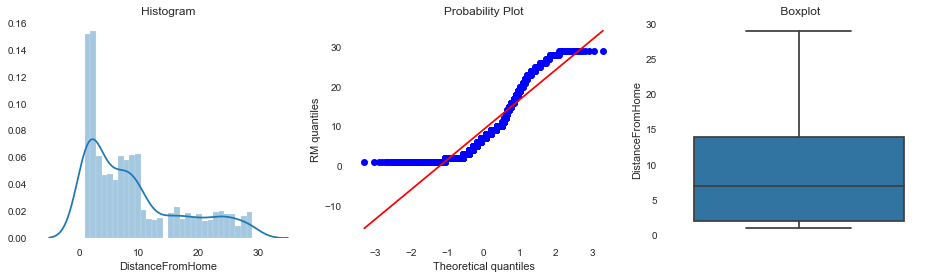

In [57]:
diagnostic_plot(df,'DistanceFromHome')

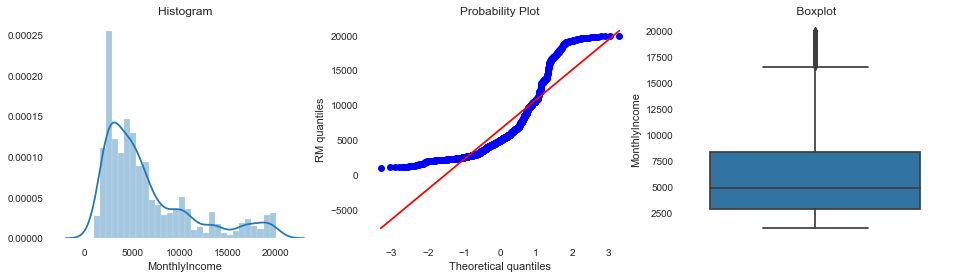

In [58]:
diagnostic_plot(df, 'MonthlyIncome')

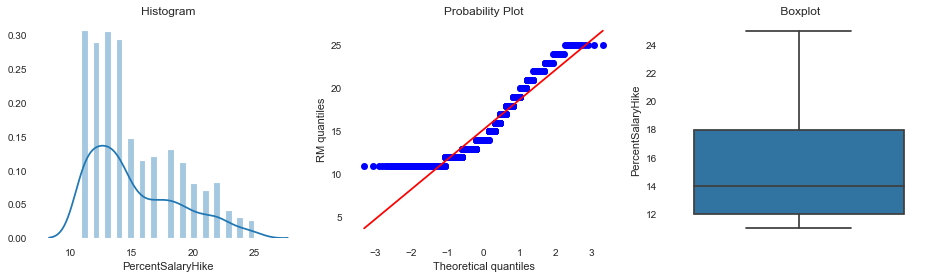

In [59]:
diagnostic_plot(df,'PercentSalaryHike')

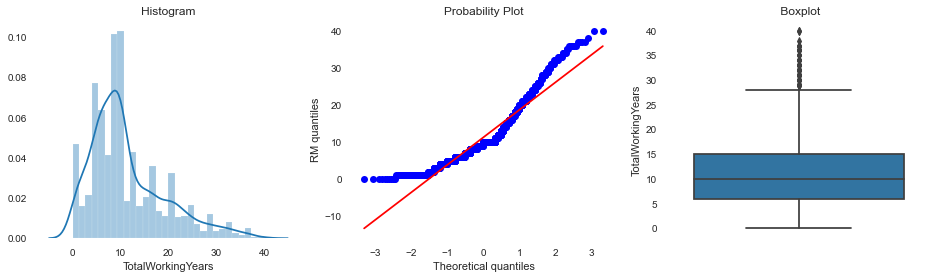

In [60]:
 diagnostic_plot(df,'TotalWorkingYears')

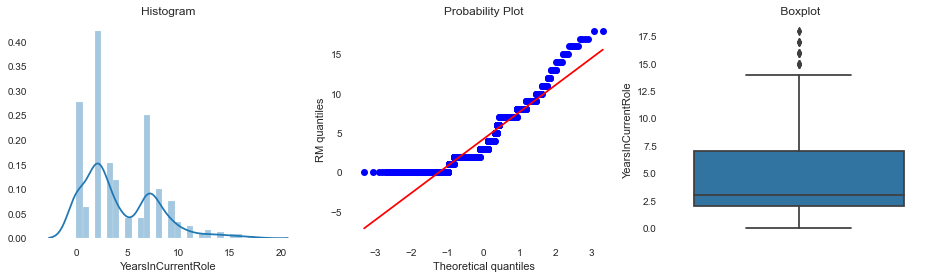

In [61]:
 diagnostic_plot(df,'YearsInCurrentRole' )

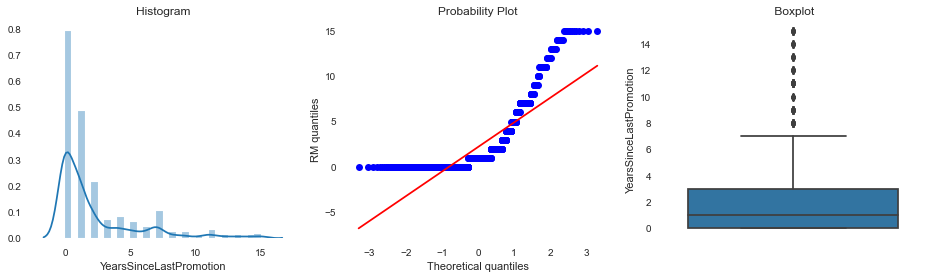

In [62]:
 diagnostic_plot(df, 'YearsSinceLastPromotion' )

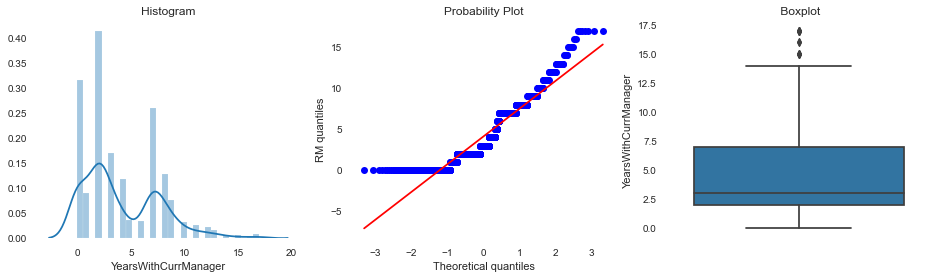

In [63]:
 diagnostic_plot(df, 'YearsWithCurrManager' )

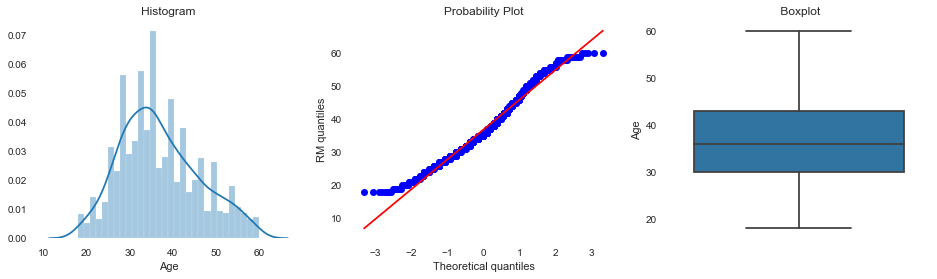

In [64]:
 diagnostic_plot(df, 'Age')

**<font color='teal'> These boxplots show the presence of outliers for the following variable MontlyIcome, YearsIncurrentRole, TotalworkingYears, YearssincelastPromotion, YearsWithcurrManager.</font>**

In [65]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,YearsWithCurrManager,growthAdvanced,TotalSatisfaction_mean,NotSatisf,Inclusion,NotInclude,Engaged,YoungAndBadPaid,StressfullEnV,lack_promotion
0,41,1,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,5,0,2.2,0,2.0,1,0,0,0,0
1,49,0,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,7,0,2.8,1,1.5,0,1,0,0,1
2,37,1,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,0,0,2.8,1,1.5,0,0,0,0,0
3,33,0,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,0,0,3.2,1,1.5,0,0,1,1,1
4,27,0,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,2,0,2.6,1,1.5,0,0,1,1,0


### 6. Features Selection 

#### 6.1  Create a dummies variable for the categorical features 

In [66]:
# Create a list categorical features and assign to a list called: todummy_list
todummy_list= ['BusinessTravel','Department','EducationField',
                  'Gender','JobRole','MaritalStatus','Over18','OverTime']

In [67]:
# concatanate the data set and dunmmies variables 
df = pd.concat([df.drop(todummy_list, axis=1), pd.get_dummies(df[todummy_list])], axis=1)

In [68]:
df.shape

(1470, 65)

In [69]:
df.columns

Index(['Age', 'Attrition', 'DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeCount', 'EmployeeNumber', 'EnvironmentSatisfaction',
       'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StandardHours', 'StockOptionLevel', 'TotalWorkingYears',
       'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany',
       'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager',
       'growthAdvanced', 'TotalSatisfaction_mean', 'NotSatisf', 'Inclusion',
       'NotInclude', 'Engaged', 'YoungAndBadPaid', 'StressfullEnV',
       'lack_promotion', 'BusinessTravel_Non-Travel',
       'BusinessTravel_Travel_Frequently', 'BusinessTravel_Travel_Rarely',
       'Department_Human Resources', 'Department_Research & Development',
       'Department_Sales', 'EducationField_Human Resources',
       'EducationField_Life

In [70]:
# The reset the index  of the dataframe 
df.reset_index(inplace=True, drop=True)

In [71]:
# Check the first five rows 
df.head()

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,41,1,1102,1,2,1,1,2,94,3,...,0,0,1,0,0,0,1,1,0,1
1,49,0,279,8,1,1,2,3,61,2,...,0,1,0,0,0,1,0,1,1,0
2,37,1,1373,2,2,1,4,4,92,2,...,0,0,0,0,0,0,1,1,0,1
3,33,0,1392,3,4,1,5,4,56,3,...,0,1,0,0,0,1,0,1,0,1
4,27,0,591,2,1,1,7,1,40,3,...,0,0,0,0,0,1,0,1,1,0


#### 6.2 Constant features 

**<font color='black'> Constant features are the type of features that contain only one value for all the outputs in the dataset. Constant features provide no information that can help in classification of the record at hand. </font>**

In [72]:
Constant_features = [feat for feat in df.columns if df[feat].std()==0]
Constant_features

['EmployeeCount', 'StandardHours', 'Over18_Y']

**<font color='black'> The value of StandardHours and employeeCount  are respectively   80 and 1 for all the outputs. So we will remove them fron the dataframe </font>**

In [73]:
df.drop ( ['EmployeeCount', 'StandardHours'], axis= 1 , inplace= True )

In [74]:
df.shape

(1470, 63)

#### 6.3 Find correlated features 

In [75]:
def correlation ( dataset, threshold):
    col_corr= set() # set of all the names of correlated columns 
    corr_matrix = dataset.corr()
    for i in range (len(corr_matrix .columns)):
        for j in range (i):
            if abs( corr_matrix.iloc[i, j]) > threshold: # we are interested in absoluhtes coefficient of correlation 
                colname= corr_matrix .columns [i] # getting the name of column 
                col_corr.add(colname)
    return col_corr

In [76]:
corr_features= correlation (df, 0.8)
len(set(corr_features))

9

In [77]:
corr_features

{'Department_Sales',
 'Gender_Male',
 'JobRole_Human Resources',
 'JobRole_Sales Executive',
 'MonthlyIncome',
 'NotInclude',
 'OverTime_Yes',
 'StressfullEnV',
 'growthAdvanced'}

**<font color='black'> We will remove Department_Sales, JobRole_Human Resources','OverTime_Yes'   feature from the dataset </font>**

In [78]:
# drop correlated features
df.drop(['Department_Sales', 'JobRole_Human Resources','OverTime_Yes'],axis=1,inplace= True )

#### 6.4  Train/test split  

In [79]:

X_train,X_test, y_train, y_test=train_test_split(df.drop(["Attrition"] , axis =1),  df.Attrition, test_size=0.3, random_state=0)
X_train.shape, X_test.shape

((1029, 59), (441, 59))

In [80]:
# let's check the variables that share the same information 
from sklearn.feature_selection import mutual_info_classif
from  sklearn.feature_selection import SelectKBest, SelectPercentile 

In [81]:
# Calculate the mutual information between the varaibles and the target 
# this returns  the mutual information value of each  feature
# the smaller the value the less information the feature has about the target
MI = mutual_info_classif( X_train, y_train)
MI

array([4.82491106e-02, 7.76464127e-03, 0.00000000e+00, 7.69372151e-03,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 2.27870429e-02,
       2.25249583e-02, 0.00000000e+00, 2.97325251e-02, 1.13615113e-02,
       0.00000000e+00, 7.25848114e-03, 0.00000000e+00, 7.28906755e-03,
       1.40718283e-02, 3.23734446e-02, 1.03677834e-02, 1.58385256e-02,
       8.16139548e-03, 5.31330556e-03, 1.32855372e-02, 1.83549631e-02,
       0.00000000e+00, 1.48660556e-02, 1.48722969e-02, 2.73670872e-02,
       0.00000000e+00, 2.59656985e-02, 3.12307507e-02, 3.22387601e-03,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 1.71257925e-03,
       8.96335739e-03, 0.00000000e+00, 5.11306523e-03, 2.91753933e-03,
       3.42797818e-03, 5.01667925e-05, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 8.26648821e-03, 7.55795800e-04, 0.00000000e+00,
       2.39225350e-03, 4.61994747e-03, 0.00000000e+00, 0.00000000e+00,
       1.58649172e-02, 2.74162194e-02, 0.00000000e+00, 1.95463261e-02,
      

In [82]:
# let's have a series for clear visualization
MI = pd.Series(MI)
MI.index= X_train.columns
MI.sort_values(ascending=False )

Age                                  0.048249
TotalWorkingYears                    0.032373
YoungAndBadPaid                      0.031231
OverTime_No                          0.030710
MonthlyIncome                        0.029733
JobRole_Sales Representative         0.027416
Inclusion                            0.027367
Engaged                              0.025966
JobInvolvement                       0.022787
JobLevel                             0.022525
MaritalStatus_Married                0.019546
YearsWithCurrManager                 0.018355
JobRole_Sales Executive              0.015865
WorkLifeBalance                      0.015839
NotSatisf                            0.014872
TotalSatisfaction_mean               0.014866
StockOptionLevel                     0.014072
YearsSinceLastPromotion              0.013286
MonthlyRate                          0.011362
TrainingTimesLastYear                0.010368
MaritalStatus_Single                 0.009911
Department_Human Resources        

 #### we can see that there a few features( left of the plot ) that seems to contribute the most to predict the target

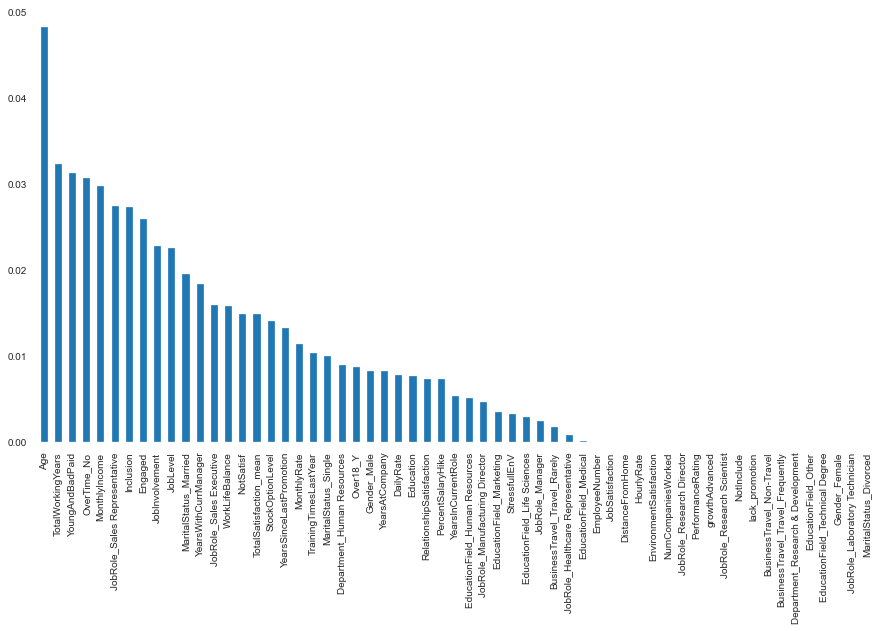

In [83]:
# and now  let's plot  the ordered Mi values per feature
MI.sort_values (ascending=False).plot.bar(figsize= (15, 8))
printmd(" #### we can see that there a few features( left of the plot ) that seems to contribute the most to predict the target")

In [84]:
# here I will select  the top 20 features 
# which  are shown below 
sel_= SelectKBest(mutual_info_classif, k=20).fit(X_train, y_train)
X_train.columns[sel_.get_support()]

Index(['Age', 'DailyRate', 'EnvironmentSatisfaction', 'JobLevel',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'StockOptionLevel', 'TotalWorkingYears', 'YearsInCurrentRole',
       'YearsWithCurrManager', 'TotalSatisfaction_mean', 'NotSatisf',
       'StressfullEnV', 'lack_promotion', 'Department_Research & Development',
       'JobRole_Research Director', 'JobRole_Sales Executive',
       'JobRole_Sales Representative', 'OverTime_No'],
      dtype='object')

In [85]:
selected_features= list(X_train.columns[sel_.get_support()])

In [86]:
selected_features.append('Attrition')

In [87]:
len(selected_features)

21

In [88]:
features =list(df.columns)
features

['Age',
 'Attrition',
 'DailyRate',
 'DistanceFromHome',
 'Education',
 'EmployeeNumber',
 'EnvironmentSatisfaction',
 'HourlyRate',
 'JobInvolvement',
 'JobLevel',
 'JobSatisfaction',
 'MonthlyIncome',
 'MonthlyRate',
 'NumCompaniesWorked',
 'PercentSalaryHike',
 'PerformanceRating',
 'RelationshipSatisfaction',
 'StockOptionLevel',
 'TotalWorkingYears',
 'TrainingTimesLastYear',
 'WorkLifeBalance',
 'YearsAtCompany',
 'YearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager',
 'growthAdvanced',
 'TotalSatisfaction_mean',
 'NotSatisf',
 'Inclusion',
 'NotInclude',
 'Engaged',
 'YoungAndBadPaid',
 'StressfullEnV',
 'lack_promotion',
 'BusinessTravel_Non-Travel',
 'BusinessTravel_Travel_Frequently',
 'BusinessTravel_Travel_Rarely',
 'Department_Human Resources',
 'Department_Research & Development',
 'EducationField_Human Resources',
 'EducationField_Life Sciences',
 'EducationField_Marketing',
 'EducationField_Medical',
 'EducationField_Other',
 'EducationField_Technica

In [89]:
features_to_drop = [feature for feature in features if feature not in selected_features]

In [90]:
df.drop(features_to_drop,axis=1 , inplace=True)

In [91]:
X_train,X_test, y_train, y_test=train_test_split(df.drop(["Attrition"] , axis =1),  df.Attrition, test_size=0.3, random_state=0)
X_train.shape, X_test.shape

((1029, 20), (441, 20))

In [92]:
X_train.head()

,Age,DailyRate,EnvironmentSatisfaction,JobLevel,MonthlyIncome,MonthlyRate,NumCompaniesWorked,StockOptionLevel,TotalWorkingYears,YearsInCurrentRole,YearsWithCurrManager,TotalSatisfaction_mean,NotSatisf,StressfullEnV,lack_promotion,Department_Research & Development,JobRole_Research Director,JobRole_Sales Executive,JobRole_Sales Representative,OverTime_No
338,30,570,4,2,6118,5431,1,3,10,9,2,3.0,1,0,1,0,0,1,0,1
363,33,350,4,1,2851,9150,1,0,1,0,0,3.0,1,1,0,0,0,0,1,0
759,45,788,2,1,2177,8318,1,0,6,3,4,2.2,0,0,0,0,0,0,0,1
793,28,895,1,1,2207,22482,1,1,4,2,2,2.6,1,1,0,1,0,0,0,1
581,30,921,4,1,3833,24375,3,2,7,2,2,2.8,1,0,0,1,0,0,0,1


### 7. Modeling 

#### The first algorithm:  Xgboost 


In [93]:
from xgboost import XGBClassifier

In [94]:
xgb = XGBClassifier()

In [95]:
xgb.fit( X_train, y_train)

XGBClassifier()

In [96]:
from sklearn.metrics import confusion_matrix,f1_score
y_pred = xgb.predict(X_test)
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[361  10]
 [ 47  23]]


In [97]:
#the classification report 
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.97      0.93       371
           1       0.70      0.33      0.45        70

    accuracy                           0.87       441
   macro avg       0.79      0.65      0.69       441
weighted avg       0.85      0.87      0.85       441



In [98]:
# The accuracy score 
print(' rf Accuracy:{}'.format(xgb.score(X_test, y_test).round(2)))
      

 rf Accuracy:0.87


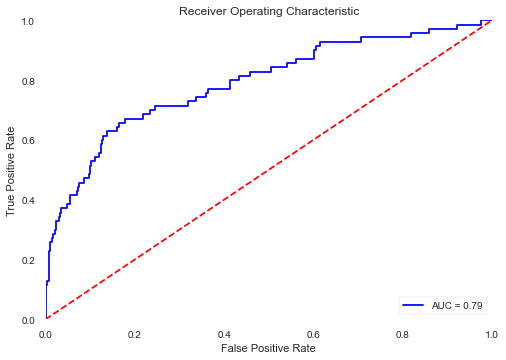

In [99]:
import sklearn.metrics as metrics
# calculate the fpr and tpr for all thresholds of the classification
probs = xgb.predict_proba(X_test)
preds = probs[:,1]
fpr, tpr, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

#### Tunning the model hyperparameters with RandomizedSearchCv
**Let's tune the algoritm hyperparameters to check if we can improve the model's performance**

In [100]:
# define in the param_grid the different hyperparameter that we w

params_grid= { "learning_rate": [ 0.05, 0.1 , 0.15, 0.2, 0.25, 0.30], 
          "max_depth" : [3, 4, 5, 6, 7,8,10, 12, 15 ],
          "min_child_weight" :[ 1,3,5,7],
          "gamma": [0.0, 0.1, 0.2, 0.3, 0,4],
          "colsample_bytree": [ 0.3, 0.4, 0.5, 0.7]}

In [101]:
from sklearn.model_selection import RandomizedSearchCV

In [102]:
random_search = RandomizedSearchCV(xgb, param_distributions=params_grid , n_iter= 5,
                                   scoring= 'roc_auc', n_jobs=-1, cv=5, verbose=3)

In [103]:
# Now we can fit the model the train  
random_search.fit(X_train , y_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    1.9s finished


RandomizedSearchCV(cv=5, estimator=XGBClassifier(), n_iter=5, n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.3, 0.4, 0.5,
                                                             0.7],
                                        'gamma': [0.0, 0.1, 0.2, 0.3, 0, 4],
                                        'learning_rate': [0.05, 0.1, 0.15, 0.2,
                                                          0.25, 0.3],
                                        'max_depth': [3, 4, 5, 6, 7, 8, 10, 12,
                                                      15],
                                        'min_child_weight': [1, 3, 5, 7]},
                   scoring='roc_auc', verbose=3)

In [104]:
random_search.best_estimator_

XGBClassifier(colsample_bytree=0.3, gamma=4, learning_rate=0.25, max_depth=12,
              min_child_weight=7)

In [105]:
random_search.best_params_

{'min_child_weight': 7,
 'max_depth': 12,
 'learning_rate': 0.25,
 'gamma': 4,
 'colsample_bytree': 0.3}

In [106]:
# Now we built our algorith with  right  hyperparameter 
Classifier = XGBClassifier(colsample_bytree=0.3, gamma=4, learning_rate=0.05, max_depth=5,
              min_child_weight=7 )

In [107]:
Classifier.fit(X_train, y_train)

XGBClassifier(colsample_bytree=0.3, gamma=4, learning_rate=0.05, max_depth=5,
              min_child_weight=7)

In [108]:
from sklearn.metrics import confusion_matrix,f1_score
y_pred = Classifier.predict(X_test)
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[368   3]
 [ 53  17]]


In [109]:
#the classification report 
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.87      0.99      0.93       371
           1       0.85      0.24      0.38        70

    accuracy                           0.87       441
   macro avg       0.86      0.62      0.65       441
weighted avg       0.87      0.87      0.84       441



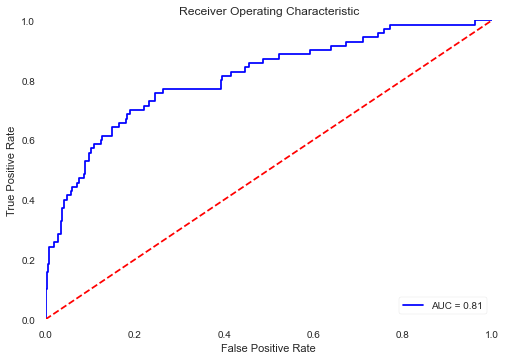

In [110]:
import sklearn.metrics as metrics
# calculate the fpr and tpr for all thresholds of the classification
probs = Classifier.predict_proba(X_test)
preds = probs[:,1]
fpr, tpr, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

#### Tuning results 
**The  tuning  did not bring substantial change to the model , the accuracy still 86% the the recall increase by 0.01. But the AUC droped of 0.02. Since we have imbalanced data the AUC is the best evaluation matrix. So we will keep the first model** 

#### The second model : Logistic Regression 

In [111]:
Class_weight= dict({0:1, 1:5})

In [112]:
#instanciate the model 
logit = LogisticRegression(class_weight= Class_weight , random_state=None )
logit.fit(X_train, y_train)

LogisticRegression(class_weight={0: 1, 1: 5})

In [113]:
# predict and the confusion matrix 
y_pred = logit.predict(X_test)
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[271 100]
 [ 27  43]]


In [114]:
# Clasification report 
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.91      0.73      0.81       371
           1       0.30      0.61      0.40        70

    accuracy                           0.71       441
   macro avg       0.61      0.67      0.61       441
weighted avg       0.81      0.71      0.75       441



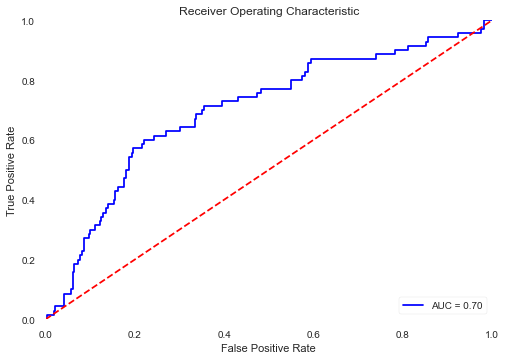

In [115]:
import sklearn.metrics as metrics
# calculate the fpr and tpr for all thresholds of the classification
probs = logit.predict_proba(X_test)
preds = probs[:,1]
fpr, tpr, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

<p><strong>The third model RandomForest </strong></p> 

In [116]:
# Instanciate the model classifier 
rf = RandomForestClassifier(n_estimators= 100, random_state=0)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

In [117]:
### predict and confusions matrix 
y_pred = rf.predict(X_test)
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[364   7]
 [ 56  14]]


In [118]:
# The classification report 
print (classification_report( y_test, y_pred))

              precision    recall  f1-score   support

           0       0.87      0.98      0.92       371
           1       0.67      0.20      0.31        70

    accuracy                           0.86       441
   macro avg       0.77      0.59      0.61       441
weighted avg       0.83      0.86      0.82       441



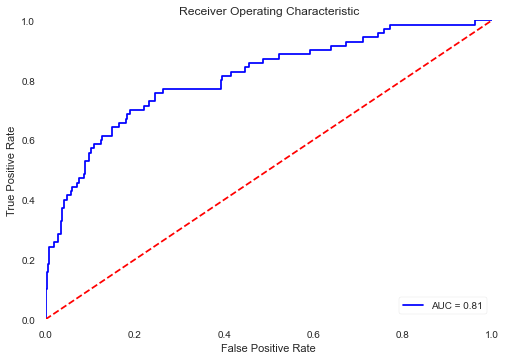

In [119]:
import sklearn.metrics as metrics
# calculate the fpr and tpr for all thresholds of the classification
probs = Classifier.predict_proba(X_test)
preds = probs[:,1]
fpr, tpr, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

<p><strong> The fourth model: AdaBoost </strong></p> 

In [120]:
# instanciate the model classifier 
Ada= AdaBoostClassifier(n_estimators= 100, random_state=0)
Ada.fit (X_train, y_train)

AdaBoostClassifier(n_estimators=100, random_state=0)

In [121]:
# predict and confusion matrix 
y_pred = Ada.predict(X_test)
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[349  22]
 [ 44  26]]


In [122]:
# The classification report 
print (classification_report( y_test, y_pred))

              precision    recall  f1-score   support

           0       0.89      0.94      0.91       371
           1       0.54      0.37      0.44        70

    accuracy                           0.85       441
   macro avg       0.71      0.66      0.68       441
weighted avg       0.83      0.85      0.84       441



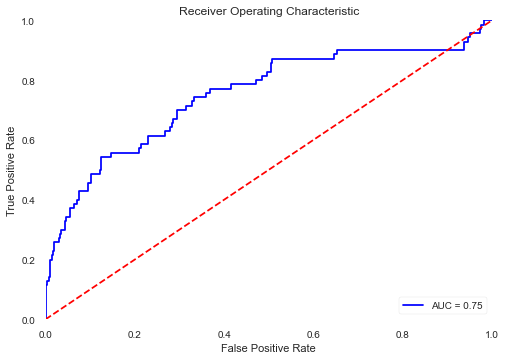

In [123]:
import sklearn.metrics as metrics
# calculate the fpr and tpr for all thresholds of the classification
probs = Ada.predict_proba(X_test)
preds = probs[:,1]
fpr, tpr, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [125]:
from sklearn import model_selection

In [126]:
# define a function to compare the evaluation metric of the different models.
def run_exps(X_train: pd.DataFrame , y_train: pd.DataFrame, X_test: pd.DataFrame, y_test: pd.DataFrame) -> pd.DataFrame:
    '''
    Lightweight script to test many models and find winners
:param X_train: training split
    :param y_train: training target vector
    :param X_test: test split
    :param y_test: test target vector
    :return: DataFrame of predictions
    '''
    
dfs = []
models = [
          ('Logit', LogisticRegression()), 
          ('RF', RandomForestClassifier()),
          ('Ada', AdaBoostClassifier()),
          ('XGB', XGBClassifier())
        ]
results = []
names = []
scoring = ['accuracy', 'precision_weighted', 'recall_weighted', 'f1_weighted', 'roc_auc']
target_names = ['0', '1']
for name, model in models:
        kfold = model_selection.KFold(n_splits=5, shuffle=True, random_state=90210)
        cv_results = model_selection.cross_validate(model, X_train, y_train, cv=kfold, scoring=scoring)
        clf = model.fit(X_train, y_train)
        y_pred = clf.predict(X_test)
        print(name)
        print(classification_report(y_test, y_pred, target_names=target_names))
results.append(cv_results)
names.append(name)
this_df = pd.DataFrame(cv_results)
this_df['model'] = name
dfs.append(this_df)
final = pd.concat(dfs, ignore_index=True)

Logit
              precision    recall  f1-score   support

           0       0.84      1.00      0.91       371
           1       0.00      0.00      0.00        70

    accuracy                           0.84       441
   macro avg       0.42      0.50      0.46       441
weighted avg       0.71      0.84      0.77       441

RF
              precision    recall  f1-score   support

           0       0.87      0.99      0.93       371
           1       0.76      0.23      0.35        70

    accuracy                           0.87       441
   macro avg       0.82      0.61      0.64       441
weighted avg       0.85      0.87      0.83       441

Ada
              precision    recall  f1-score   support

           0       0.89      0.95      0.92       371
           1       0.58      0.36      0.44        70

    accuracy                           0.86       441
   macro avg       0.73      0.65      0.68       441
weighted avg       0.84      0.86      0.84       441

XGB
  

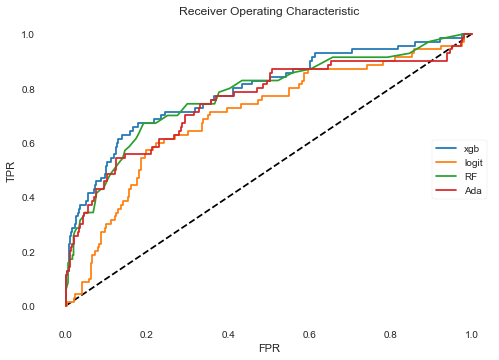

In [127]:
#ROC Curve
from sklearn.metrics import roc_curve
probs = xgb.predict_proba(X_test)
preds = probs[:,1]
fpr1, tpr1, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)

probs = logit.predict_proba(X_test)
preds = probs[:,1]
fpr2, tpr2, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)

probs = rf.predict_proba(X_test)
preds = probs[:,1]
fpr3, tpr3, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)

probs = Ada.predict_proba(X_test)
preds = probs[:,1]
fpr4, tpr4, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)

plt.plot([0,1],[0,1], 'k--')
plt.plot(fpr1, tpr1, label= "xgb")
plt.plot(fpr2, tpr2, label= "logit")
plt.plot(fpr3, tpr3, label= "RF")
plt.plot(fpr4, tpr4, label= "Ada")
plt.legend(loc = 'right')
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title('Receiver Operating Characteristic')
plt.show()




**Although the RandomForest classifier has the higest accuracy score, the comparaison the of the AUC shows that Xgboost classifier is the best model. The AUC is 0.81**

### 8. Documentation 

**Model evaluation **

**The accuarcy of the ensemble method( Xgboost, Randomforest, and  adaboost) is 87%, while Logistic regression has 84%. Xgboost is the best model respect to AUC  evaluation metrics.**

**The fifteen(15) best predictions , that is varaible variable with high correlation with the lablel are the followings** 
  1. Age
  2. HourlyRate
  3. JobLevel
  4. MonthlyIncome
  5. NumCompaniesWorked
  6. YearsAtCompany
  7. YearsInCurrentRole
  8. YearsWithCurrManager
  9. TotalSatisfaction_mean
  10. YoungAndBadPaid
  11. BusinessTravel_Non-Travel

####  RECOMMANDATIONS 

**1. First Recommendation**

The analysis shows that remuneration (HourlyRate, MonthlyIncome, JobLevel) is one of the leading causes of employee attrition. We recommend a salary survey to find the optimal salary range in the industry of the company. Managers could do that through the collection of external data on the internet. Also, it is essential to include into the exit interview questions about remuneration. Those actions will allow the company to implement a competitive remuneration package that will attract and retain employees. 

**2 Second Recommmandation**
The age histogram shows that 50% of the employees are under 40 years. The company needs to create an innovative environment and focus on employee mentor relationships to connect the younger and old employees. That will increases job satisfaction and business growth.

**Third Recommendations** 

The remaining variables are related to the position's nature (YearsAtCompanies, YearsInCurrent Role, YearsWithCurrManager Total SatisFaction mean. Top Managers need to review the internal process through a comprehensive job description and evaluation to allow more growth opportunities for the younger generation.  This way, employees will not spend many years in the same position. 












